# Object Detection Demo
Welcome to the object detection inference walkthrough!  This notebook will walk you step by step through the process of using a pre-trained model to detect objects in an image. Make sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/installation.md) before you start.

# Imports

In [283]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

os.environ["CUDA_VISIBLE_DEVICES"]=""

## Env setup

In [284]:
# This is needed to display the images.
%matplotlib inline

# This is needed since the notebook is stored in the object_detection folder.
sys.path.insert(0, "/home/florian/models/research/object_detection")

## Object detection imports
Here are the imports from the object detection module.

In [285]:
from utils import label_map_util
from utils import visualization_utils as vis_util

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing `PATH_TO_CKPT` to point to a new .pb file.  

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

In [286]:
# What model to download.
PATH = '/media/florian/Neumann/Kaggle/Data_Science_Bowl_2018/nuclei_detection/rcnn_inference'

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = PATH + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join('/media/florian/Neumann/Kaggle/Data_Science_Bowl_2018/nuclei_detection/data', 'nuclei_label_map.pbtxt')

NUM_CLASSES = 1

## Download Model

## Load a (frozen) Tensorflow model into memory.

In [287]:
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [288]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

## Helper code

In [289]:
RCNN_THRSH = 0.25
UNET_THRSH = 0.5
IOU_THRSH = 0.1

# Detection

In [290]:
# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.

import glob

TEST_IMAGE_PATHS = glob.glob('/media/florian/Neumann/Kaggle/Data_Science_Bowl_2018/data/stage1_test/*/images/*.png')

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 12)

#TEST_IMAGE_PATHS

In [291]:
import torch
import torch.nn as nn

from torch.autograd import Variable
import torch.nn.functional as F

from skimage.restoration import denoise_tv_chambolle

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        # encoding layers
        self.conv_1a = nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1)
        self.conv_1b = nn.Conv2d(16, 16, kernel_size=3, stride=1, padding=1)
        self.max_pool_1 = nn.MaxPool2d(kernel_size=2)
        self.conv_2a = nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1)
        self.conv_2b = nn.Conv2d(32, 32, kernel_size=3, stride=1, padding=1)
        self.max_pool_2 = nn.MaxPool2d(kernel_size=2)
        self.conv_3a = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv_3b = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1)
        self.max_pool_3 = nn.MaxPool2d(kernel_size=2)
        self.conv_4a = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.conv_4b = nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1)
        self.max_pool_4 = nn.MaxPool2d(kernel_size=2)
        self.conv_5a = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.conv_5b = nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1)
        # decoding layers
        self.conv_6a = nn.Conv2d(384, 128, kernel_size=3, stride=1, padding=1)
        self.conv_6b = nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1)
        self.conv_7a = nn.Conv2d(192, 64, kernel_size=3, stride=1, padding=1)
        self.conv_7b = nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1)
        self.conv_8a = nn.Conv2d(96, 32, kernel_size=3, stride=1, padding=1)
        self.conv_8b = nn.Conv2d(32, 32, kernel_size=3, stride=1, padding=1)
        self.conv_9a = nn.Conv2d(48, 16, kernel_size=3, stride=1, padding=1)
        self.conv_9b = nn.Conv2d(16, 16, kernel_size=3, stride=1, padding=1)

        # decong layers
        self.deconv1 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.deconv2 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.deconv3 = nn.ConvTranspose2d(64, 32, kernel_size=2, stride=2)
        self.deconv4 = nn.ConvTranspose2d(32, 16, kernel_size=2, stride=2)
        # upsampling layers
        self.upsample = nn.UpsamplingBilinear2d(scale_factor=2)  
        # output layer
        self.out_mask = nn.Conv2d(16, 1, kernel_size=1, stride=1)
        # activation layers
        self.elu = nn.ELU(inplace=True)
        # dropout
        self.dropout = nn.Dropout(0.25)

    def forward(self, x):
        # encoding layers
        e1a = self.dropout(self.elu(self.conv_1a(x)))
        e1b = self.elu(self.conv_1b(e1a))
        e1 = self.max_pool_1(e1b)
        e2a = self.dropout(self.elu(self.conv_2a(e1)))
        e2b = self.elu(self.conv_2b(e2a))
        e2 = self.max_pool_1(e2b)
        e3a = self.dropout(self.elu(self.conv_3a(e2)))
        e3b = self.elu(self.conv_3b(e3a))
        e3 = self.max_pool_1(e3b)
        e4a = self.dropout(self.elu(self.conv_4a(e3)))
        e4b = self.elu(self.conv_4b(e4a))
        e4 = self.max_pool_1(e4b)
        e5a = self.dropout(self.elu(self.conv_5a(e4)))
        e5b = self.elu(self.conv_5b(e5a))
        # decoding layers
        u1 = self.upsample(e5b)
        c1 = torch.cat((e4b, u1), 1)
        d1a = self.dropout(self.elu(self.conv_6a(c1)))
        d1b = self.elu(self.conv_6b(d1a))

        u2 = self.upsample(d1b)
        c2 = torch.cat((e3b, u2), 1)
        d2a = self.dropout(self.elu(self.conv_7a(c2)))
        d2b = self.elu(self.conv_7b(d2a))

        u3 = self.upsample(d2b)
        c3 = torch.cat((e2b, u3), 1)
        d3a = self.dropout(self.elu(self.conv_8a(c3)))
        d3b = self.elu(self.conv_8b(d3a))

        u4 = self.upsample(d3b)
        c4 = torch.cat((e1b, u4), 1)
        d4a = self.dropout(self.elu(self.conv_9a(c4)))
        d4b = self.elu(self.conv_9b(d4a))

        # output
        out_msk = self.out_mask(d4b)   # 1x256x256
        
        return out_msk

net_single = UNet()
net_single.load_state_dict(torch.load('../models-pytorch/best_UNet_single_nuclei_lossless_augmentations_std-fn.pth', map_location=lambda storage, loc: storage))
net_single.cpu().eval()

def normalize_img(img_arr):
    img_min = np.min(img_arr)
    img_max = np.max(img_arr)
    img_mean = np.mean(img_arr)
    img_out = (img_arr - img_mean) / (img_max - img_min)
    return img_out

def calc_iou(msk_a, msk_b):
    msk_a = msk_a.astype(np.bool)
    msk_b = msk_b.astype(np.bool)

    intersection = np.logical_and(msk_a, msk_b)
    union = np.logical_or(msk_a, msk_b)

    return intersection.sum() / float(union.sum())

def rank_boxes_size(bboxes):
    idx = list(range(bboxes.shape[1]))
    
    areas = []
    for i in range(bboxes.shape[1]):
        width = bboxes[0][i][3] - bboxes[0][i][1]
        height = bboxes[0][i][2] - bboxes[0][i][0]
        areas.append(width * height)
        
    sorted_idx = [ix for _, ix in sorted(zip(areas, idx))]
    
    #for j in range(3):
    #    print(sorted_idx[j], areas[sorted_idx[j]])
    
    return sorted_idx

def rank_boxes_confidence(confidences):
    idx = list(range(confidences.shape[1]))
    sorted_idx = reversed(idx)
    
    #print(confidences.shape)
    
    return sorted_idx

def mask_nuc(img, bboxes, confidences):
    out = np.zeros((img.shape[0], img.shape[1]), dtype=np.int32)
    check_mask = np.zeros((img.shape[0], img.shape[1]), dtype=np.int32)
    img_h = img.shape[0]
    img_w = img.shape[1]
    num = 1
    
    #sorted_idx = rank_boxes(bboxes)
    sorted_idx = rank_boxes_confidence(confidences)
    
    for i in sorted_idx:
        if confidences[0][i] > RCNN_THRSH:
            temp_ = np.zeros((img.shape[0], img.shape[1]), dtype=np.int32)
            temp_check = np.zeros((img.shape[0], img.shape[1]), dtype=np.int32)
            # get the bounding box and scale it back to the right size
            xmin = max(0, int( bboxes[0][i][1] * img.shape[1] ))
            ymin = max(0, int( bboxes[0][i][0] * img.shape[0] ))
            xmax = min(img_w, int( bboxes[0][i][3] * img.shape[1] ))
            ymax = min(img_h, int( bboxes[0][i][2] * img.shape[0] ))
            
            #if not (np.sum(out[ymin:ymax, xmin:xmax]) > (nuc_h * nuc_w * 0.25)):
            nuc = img[ymin:ymax, xmin:xmax, :]

            #nuc = standardize_img(nuc)
            img_for_net = normalize_img(resize(nuc, (64, 64), mode='constant', preserve_range=True)) 
            img_for_net = np.expand_dims(img_for_net, axis=-1)
            img_for_net = img_for_net.transpose((3, 2,0,1)).reshape((1,3,64,64)).astype(np.float32)
            pred_msk = net_single(Variable(torch.from_numpy(img_for_net), volatile=True))
            pred_msk = F.sigmoid(pred_msk)

            predicted_mask = np.where(pred_msk.data.numpy().squeeze() > UNET_THRSH, 1, 0).astype(np.int32)
            predicted_mask = resize(predicted_mask, (ymax-ymin, xmax-xmin), mode='constant', preserve_range=True)
            
            check_ = check_mask[ymin:ymax, xmin:xmax]
            
            #print(calc_iou(predicted_mask, check_))
            if calc_iou(predicted_mask, check_) < IOU_THRSH:
                temp_check[ymin:ymax, xmin:xmax] = predicted_mask
                check_mask = np.add(temp_check, check_mask)

                predicted_mask = np.where(predicted_mask == 1, num, 0)

                temp_[ymin:ymax, xmin:xmax] = predicted_mask.astype(np.int32)

                out = np.maximum(temp_, out)

                num += 1
            
    return out, check_mask


/home/florian/anaconda3/lib/python3.5/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/home/florian/anaconda3/lib/python3.5/site-packages/torch/nn/modules/upsampling.py:180: UserWarning: nn.UpsamplingBilinear2d is deprecated. Use nn.Upsample instead.
  warnings.warn("nn.UpsamplingBilinear2d is deprecated. Use nn.Upsample instead.")


Y doesnt match! 52b267e20519174e3ce1e1994b5d677804b16bc670aa5f6ffb6344a0fdf63fde
X doesnt match! 52b267e20519174e3ce1e1994b5d677804b16bc670aa5f6ffb6344a0fdf63fde


/home/florian/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:111: RuntimeWarning: invalid value encountered in true_divide


Y doesnt match! b83d1d77935b6cfd44105b54600ffc4b6bd82de57dec65571bcb117fa8398ba3
X doesnt match! b83d1d77935b6cfd44105b54600ffc4b6bd82de57dec65571bcb117fa8398ba3
Y doesnt match! fe9adb627a6f45747c5a8223b671774791ededf9364f6544be487c540107fa4f
X doesnt match! fe9adb627a6f45747c5a8223b671774791ededf9364f6544be487c540107fa4f
Y doesnt match! ca20076870e8fb604e61802605a9ac45419c82dd3e23404c56c4869f9502a5ef
X doesnt match! ca20076870e8fb604e61802605a9ac45419c82dd3e23404c56c4869f9502a5ef
Y doesnt match! 1747f62148a919c8feb6d607faeebdf504b5e2ad42b6b1710b1189c37ebcdb2c
X doesnt match! 1747f62148a919c8feb6d607faeebdf504b5e2ad42b6b1710b1189c37ebcdb2c
Y doesnt match! 53df5150ee56253fe5bc91a9230d377bb21f1300f443ba45a758bcb01a15c0e4
X doesnt match! 53df5150ee56253fe5bc91a9230d377bb21f1300f443ba45a758bcb01a15c0e4
Y doesnt match! 8b59819fbc92eefe45b1db95c0cc3a467ddcfc755684c7f2ba2f6ccb9ad740ab
X doesnt match! 8b59819fbc92eefe45b1db95c0cc3a467ddcfc755684c7f2ba2f6ccb9ad740ab
Y doesnt match! 43a71aeb641f

/home/florian/anaconda3/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Y doesnt match! 38f5cfb55fc8b048e82a5c895b25fefae7a70c71ab9990c535d1030637bf6a1f
X doesnt match! 38f5cfb55fc8b048e82a5c895b25fefae7a70c71ab9990c535d1030637bf6a1f
Y doesnt match! 1962d0c5faf3e85cda80e0578e0cb7aca50826d781620e5c1c4cc586bc69f81a
X doesnt match! 1962d0c5faf3e85cda80e0578e0cb7aca50826d781620e5c1c4cc586bc69f81a
Y doesnt match! 9f17aea854db13015d19b34cb2022cfdeda44133323fcd6bb3545f7b9404d8ab
X doesnt match! 9f17aea854db13015d19b34cb2022cfdeda44133323fcd6bb3545f7b9404d8ab
Y doesnt match! d8d4bf68a76e4e4c5f21de7ac613451f7115a04db686151e78b8ec0b6a22022b
X doesnt match! d8d4bf68a76e4e4c5f21de7ac613451f7115a04db686151e78b8ec0b6a22022b
Y doesnt match! c8e79ff4ac55f4b772057de28e539727b7f4f2a3de73bf7a082a0ace86d609eb
X doesnt match! c8e79ff4ac55f4b772057de28e539727b7f4f2a3de73bf7a082a0ace86d609eb
Y doesnt match! 699f2992cd71e2e28cf45f81347ff22e76b37541ce88087742884cd0e9aadc68
X doesnt match! 699f2992cd71e2e28cf45f81347ff22e76b37541ce88087742884cd0e9aadc68
Y doesnt match! 550450e4bff4

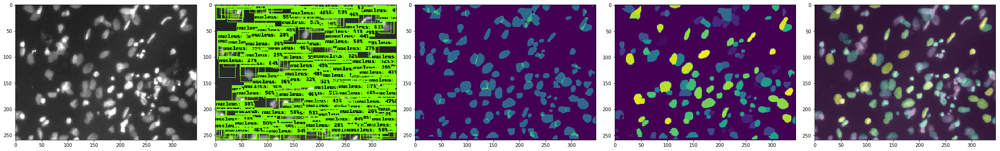

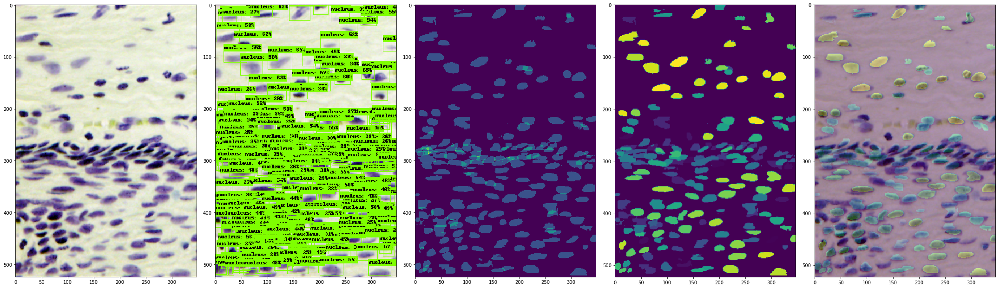

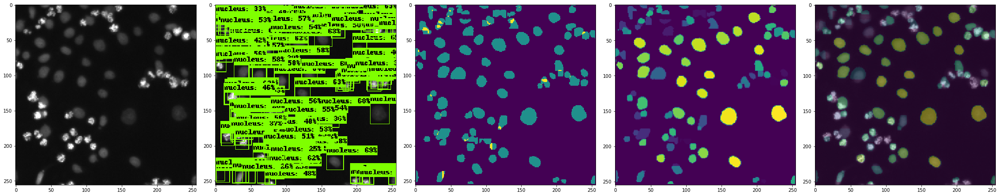

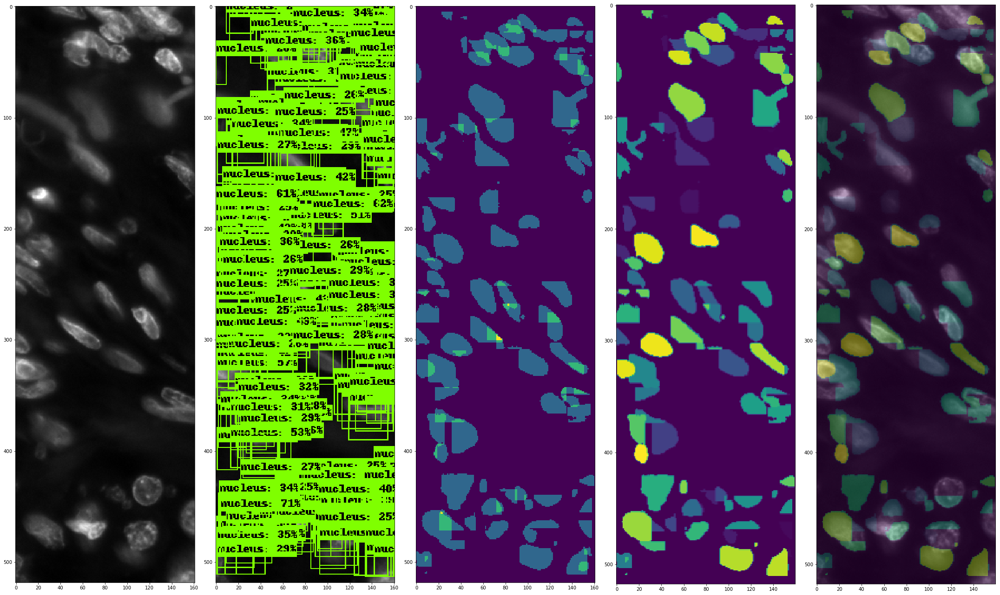

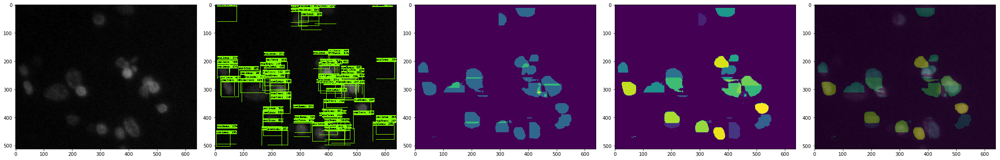

...

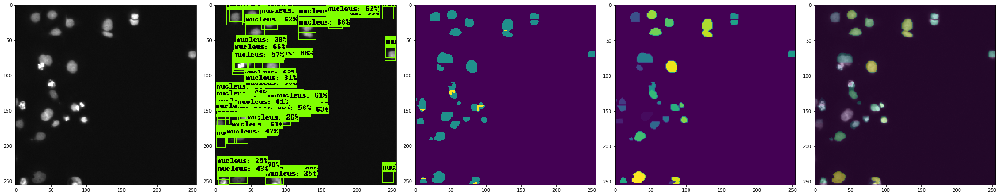

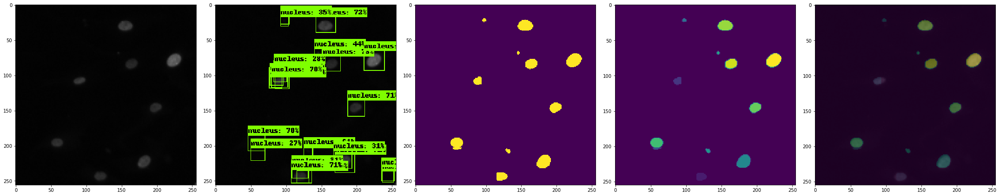

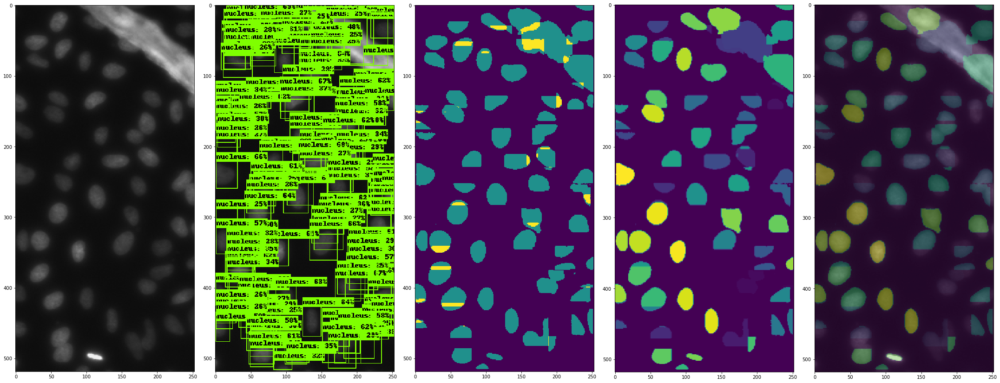

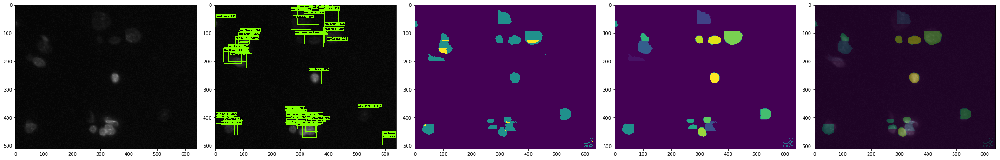

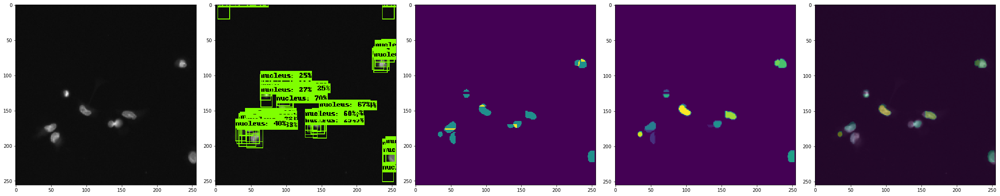

In [292]:
import io
import time

from skimage.io import imread
from skimage.transform import resize

test_ids = []
rle_preds = []

def rle_encoding(x):
    dots = np.where(x.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

def prob_to_rles(lab_img):
    for i in range(1, lab_img.max() + 1):
        yield rle_encoding(lab_img == i)
        

with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for i, image_path in enumerate(TEST_IMAGE_PATHS):
            tst_id = os.path.basename(image_path).replace('.png', '')
            
            start = time.time()
            image = imread(image_path)[:,:,:3]
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = image.astype(np.uint8)
            
            image_4_net = resize(image_np, (1024, 1024), preserve_range=True)
            
            # make predictions on the full image
            image_np_expanded = np.expand_dims(image_4_net, axis=0)
            #img_for_net = standardize_img(image_np)
            #img_for_net = normalize_img(resize(img_for_net, (448, 448, 3), mode='constant', preserve_range=True))
            #img_for_net = np.expand_dims(img_for_net, axis=-1)
            #img_for_net = img_for_net.transpose((3,2,0,1)).reshape((1,3,448,448)).astype(np.float32)
            #full_img_pred = F.sigmoid(net_full(Variable(torch.from_numpy(img_for_net), volatile=True)))
            #predicted_full_mask = np.where(full_img_pred.data.numpy().squeeze() > 0.5, 1, 0).astype(np.int32)
            #predicted_full_mask = resize(predicted_full_mask, (image_np.shape[0], image_np.shape[1]))
            
            #print(image_np_expanded.shape)
            # Make RCNN predictions
            (boxes, scores, classes, num) = sess.run(
                [detection_boxes, detection_scores, detection_classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})

            # make individual nuclei predictions
            labeled_mask, check_mask = mask_nuc(image, boxes, scores)
            labeled_mask = resize(labeled_mask, (image.shape[0] - 1, image.shape[1] - 1), preserve_range=True).astype(np.int32)
            
            #print(image.shape, labeled_mask.shape)
            
            if labeled_mask.shape[0] != image.shape[0]:
                print('Y doesnt match!', tst_id)
                
            if labeled_mask.shape[1] != image.shape[1]:
                print('X doesnt match!', tst_id)
            
            rle = list(prob_to_rles(labeled_mask))
            rle_preds.extend(rle)
            test_ids.extend([tst_id] * len(rle))
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                use_normalized_coordinates=True,
                line_thickness=1,
               max_boxes_to_draw=300,
                min_score_thresh=RCNN_THRSH)
            #print("Took {:.2} seconds".format(time.time() - start))
            
            #print(tst_id)
            
            
            plt.figure(figsize=(30,20))
            plt.subplot(151)
            plt.imshow(image)
            plt.subplot(152)
            plt.imshow(image_np)
            plt.subplot(153)
            plt.imshow(check_mask)
            plt.subplot(154)
            plt.imshow(labeled_mask)
            plt.subplot(155)
            plt.imshow(image)
            plt.imshow(labeled_mask, alpha=0.4)
            plt.tight_layout()
            plt.savefig('../img_masks/detects_UNet_{}.jpg'.format(i))
            #plt.show()
            
            

In [293]:
import pandas as pd

sub = pd.DataFrame()
sub['ImageId'] = test_ids
sub['EncodedPixels'] = pd.Series(rle_preds).apply(lambda x: ' '.join(str(y) for y in x))
print(sub.head())

                                             ImageId  \
0  52b267e20519174e3ce1e1994b5d677804b16bc670aa5f...   
1  52b267e20519174e3ce1e1994b5d677804b16bc670aa5f...   
2  52b267e20519174e3ce1e1994b5d677804b16bc670aa5f...   
3  52b267e20519174e3ce1e1994b5d677804b16bc670aa5f...   
4  52b267e20519174e3ce1e1994b5d677804b16bc670aa5f...   

                                       EncodedPixels  
0  2147 5 2404 1 2412 1 3115 1 3326 1 3375 2 3584...  
1  4665 2 4926 2 5182 1 5280 1 5537 1 5713 1 5794...  
2  6310 1 6736 1 7086 1 7600 3 7863 1 9248 1 9509...  
3  2293 1 4364 1 5289 1 5550 1 5810 1 6070 1 6330...  
4  479 1 738 1 997 1 1256 1 1515 1 1774 1 2034 1 ...  


In [294]:
sub.to_csv('../subm/faster_rcnn_to_unet.csv', index=False)